<a href="https://colab.research.google.com/github/OmerOzbektas/Model-Predictive-Control-MPC-for-Autonomous-Vehicle-Lateral-Dynamics/blob/main/MPC_LATERAL_CAR_CONTROL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.gridspec as gridspec
from dataclasses import dataclass
from scipy.signal import cont2discrete
from scipy.integrate import solve_ivp
import time
from IPython.display import HTML

In [ ]:
# Configuration & Constants
@dataclass
class VehicleParams:
    """Data class to hold vehicle physical parameters."""
    m: float = 1500.0      # Mass [kg]
    Iz: float = 3000.0     # Moment of inertia [kg*m^2]
    Caf: float = 19000.0   # Front tire cornering stiffness [N/rad]
    Car: float = 33000.0   # Rear tire cornering stiffness [N/rad]
    lf: float = 2.0        # Distance from CG to front axle [m]
    lr: float = 3.0        # Distance from CG to rear axle [m]
    vx: float = 20.0       # Longitudinal velocity [m/s] (assumed constant)

@dataclass
class MPCParams:
    """MPC Controller settings."""
    Ts: float = 0.05       # Sampling time [s] - 0.05 is a good rate for animation smoothness
    Horizon: int = 20      # Prediction horizon
    q_y: float = 10.0      # Penalty for Y position error
    q_psi: float = 100.0   # Penalty for Yaw angle error
    r_input: float = 1.0   # Penalty for steering input change

# MODEL & CONTROLLER CLASS
class LateralMPC:
    def __init__(self, vehicle: VehicleParams, mpc: MPCParams):
        self.vp = vehicle
        self.mp = mpc

        # Continuous-time model matrices
        A = np.array([
            [-(2*self.vp.Caf + 2*self.vp.Car)/(self.vp.m*self.vp.vx), 0, -self.vp.vx - (2*self.vp.Caf*self.vp.lf - 2*self.vp.Car*self.vp.lr)/(self.vp.m*self.vp.vx), 0],
            [0, 0, 1, 0],
            [-(2*self.vp.lf*self.vp.Caf - 2*self.vp.lr*self.vp.Car)/(self.vp.Iz*self.vp.vx), 0, -(2*self.vp.lf**2*self.vp.Caf + 2*self.vp.lr**2*self.vp.Car)/(self.vp.Iz*self.vp.vx), 0],
            [1, self.vp.vx, 0, 0]
        ])
        B = np.array([[2*self.vp.Caf / self.vp.m], [0], [2*self.vp.lf*self.vp.Caf / self.vp.Iz], [0]])
        C = np.array([[0, 1, 0, 0], [0, 0, 0, 1]])
        D = np.array([[0], [0]])

        # Discretization using Zero-Order Hold (ZOH)
        sys_d = cont2discrete((A, B, C, D), self.mp.Ts, method='zoh')
        self.Ad, self.Bd, self.Cd = sys_d[0], sys_d[1], sys_d[2]

        # State Augmentation for MPC formulation
        n_x, n_u = self.Ad.shape[0], self.Bd.shape[1]
        self.A_aug = np.block([[self.Ad, self.Bd], [np.zeros((n_u, n_x)), np.eye(n_u)]])
        self.B_aug = np.vstack([self.Bd, np.eye(n_u)])
        self.C_aug = np.hstack([self.Cd, np.zeros((self.Cd.shape[0], n_u))])

        self._build_prediction_matrices()

    def _build_prediction_matrices(self):
        # Build prediction matrices for the MPC problem
        hz = self.mp.Horizon
        nx_aug, nu, ny = self.A_aug.shape[0], self.B_aug.shape[1], self.C_aug.shape[0]
        Q_bar = np.kron(np.eye(hz), np.diag([self.mp.q_psi, self.mp.q_y])) # Weighting matrix for states
        R_bar = np.kron(np.eye(hz), np.array([[self.mp.r_input]])) # Weighting matrix for inputs

        self.Phi = np.zeros((ny * hz, nx_aug))
        self.Gamma = np.zeros((ny * hz, nu * hz))
        A_pow = np.eye(nx_aug)

        # Construct prediction matrices Phi and Gamma
        for i in range(hz):
            A_next = self.A_aug @ A_pow
            self.Phi[i*ny:(i+1)*ny, :] = self.C_aug @ A_next
            for j in range(i + 1):
                term = self.C_aug @ np.linalg.matrix_power(self.A_aug, i - j) @ self.B_aug
                self.Gamma[i*ny:(i+1)*ny, j*nu:(j+1)*nu] = term
            A_pow = A_next

        # Pre-compute H and M for quadratic programming solution
        self.H = self.Gamma.T @ Q_bar @ self.Gamma + R_bar
        self.M = np.linalg.inv(self.H) @ self.Gamma.T @ Q_bar

    def solve(self, current_state, last_input, reference_trajectory):
        # Solve the MPC problem for the optimal control input
        x_aug = np.concatenate([current_state, [last_input]])
        ref_vec = reference_trajectory.reshape(-1)
        prediction_error = self.Phi @ x_aug - ref_vec
        delta_u_opt = (- self.M @ prediction_error)[0] # Calculate optimal change in input
        u_opt = np.clip(last_input + delta_u_opt, -np.radians(30), np.radians(30)) # Apply input limits
        return u_opt

Calculating simulation (Please wait)...
Calculation complete. Duration: 0.1188 s. Starting animation...


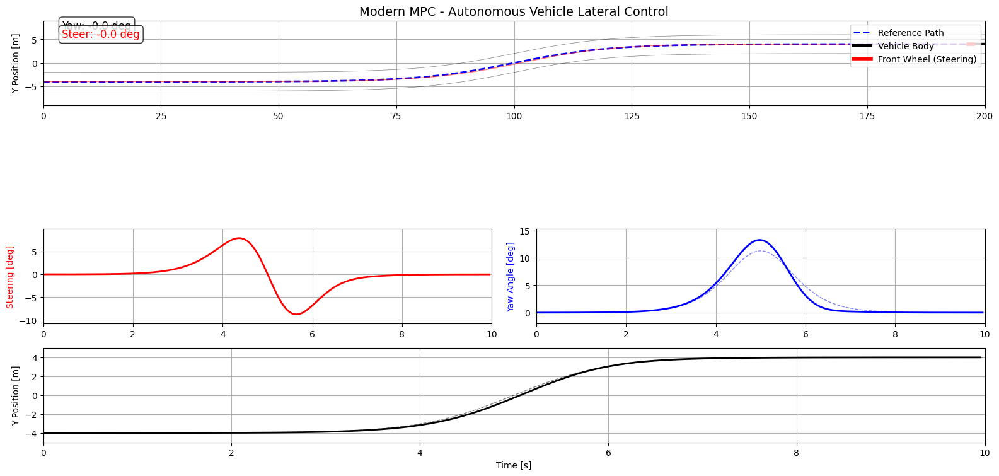

In [ ]:
# TRAJECTORY GENERATOR
def generate_reference_path(t_total, dt, vx):
    # Generates a double lane change reference trajectory
    t = np.arange(0, t_total + dt, dt)
    x = vx * t
    y_ref = 4.0 * np.tanh(t - t_total/2)
    dy = np.gradient(y_ref, x)
    psi_ref = np.arctan(dy)
    refs = np.vstack([psi_ref, y_ref]).T
    return t, x, refs

# SIMULATION FUNCTION (Dynamics)
def vehicle_dynamics_continuous(t, state, vehicle, u):
    # Defines the continuous-time vehicle dynamics
    vy, psi, psi_dot, Y = state
    delta = u # Steering angle is the control input
    m, vx, Caf, Car, lf, lr, Iz = vehicle.m, vehicle.vx, vehicle.Caf, vehicle.Car, vehicle.lf, vehicle.lr, vehicle.Iz

    # Calculate slip angles and tire forces
    alpha_f = delta - (vy + lf * psi_dot) / vx
    alpha_r = - (vy - lr * psi_dot) / vx
    Fyf = Caf * alpha_f
    Fyr = Car * alpha_r

    # Equations of motion
    vy_dot = (Fyf + Fyr) / m - vx * psi_dot
    psi_dot_dot = (lf * Fyf - lr * Fyr) / Iz
    Y_dot = vx * np.sin(psi) + vy * np.cos(psi)

    return [vy_dot, psi_dot, psi_dot_dot, Y_dot]

# MAIN EXECUTION & ANIMATION
if __name__ == "__main__":
    # SIMULATION SETUP
    vp = VehicleParams()
    mpc_params = MPCParams(Ts=0.05, Horizon=15) # Ts is important for animation speed
    controller = LateralMPC(vp, mpc_params)

    sim_duration = 10.0
    t_sim, x_sim, refs = generate_reference_path(sim_duration, mpc_params.Ts, vp.vx)

    n_steps = len(t_sim)
    states_history = np.zeros((n_steps, 4))
    u_history = np.zeros(n_steps)

    # Initial state (start at Y of reference trajectory)
    current_state = np.array([0.0, 0.0, 0.0, refs[0,1]])
    current_u = 0.0
    states_history[0] = current_state

    print("Calculating simulation (Please wait)...")
    start_time = time.time()

    # --- SIMULATION LOOP (Pre-calculate all data) ---
    for i in range(n_steps - 1):
        # Determine the reference trajectory for the current horizon
        if i + mpc_params.Horizon < n_steps:
            ref_horizon = refs[i:i+mpc_params.Horizon]
        else:
            # Pad with the last reference point if horizon exceeds simulation steps
            padding = (i + mpc_params.Horizon) - n_steps
            ref_horizon = np.vstack([refs[i:], np.tile(refs[-1], (padding, 1))])

        u_opt = controller.solve(current_state, current_u, ref_horizon) # Get optimal steering input

        # Integrate vehicle dynamics for one time step
        sol = solve_ivp(vehicle_dynamics_continuous, [t_sim[i], t_sim[i+1]],
                        current_state, args=(vp, u_opt), method='RK45')

        # Update current state and input
        current_state = sol.y[:, -1]
        current_u = u_opt
        states_history[i+1] = current_state
        u_history[i+1] = u_opt

    print(f"Calculation complete. Duration: {time.time() - start_time:.4f} s. Starting animation...")

    # ANIMATION SETUP

    # Prepare data for plotting
    X_actual = x_sim # X position under constant velocity assumption
    Y_actual = states_history[:, 3]
    Psi_actual = states_history[:, 1]
    Steer_actual = u_history

    # Figure and Grid settings
    fig = plt.figure(figsize=(16, 9), facecolor='white')
    gs = gridspec.GridSpec(3, 2, height_ratios=[3, 1, 1])

    # Top Main Plot
    ax0 = fig.add_subplot(gs[0, :])
    ax0.set_title('Modern MPC - Autonomous Vehicle Lateral Control', fontsize=14)
    ax0.plot(x_sim, refs[:, 1], 'b--', linewidth=2, label='Reference Path')

    # Lane lines
    lane_width = 4.0
    ax0.plot(x_sim, refs[:, 1] + lane_width/2, 'k-', linewidth=0.5, alpha=0.5)
    ax0.plot(x_sim, refs[:, 1] - lane_width/2, 'k-', linewidth=0.5, alpha=0.5)

    # Car drawing elements (initially empty)
    car_body, = ax0.plot([], [], 'k-', linewidth=3, label='Vehicle Body')
    car_f_wheel, = ax0.plot([], [], 'r-', linewidth=4, label='Front Wheel (Steering)')
    car_r_wheel, = ax0.plot([], [], 'r-', linewidth=4)
    car_f_ext, = ax0.plot([], [], 'r--', linewidth=1) # Steering direction extension
    car_traj, = ax0.plot([], [], 'r-', linewidth=1, alpha=0.5) # Path trace of the vehicle

    # Text boxes for displaying current values
    bbox_props = dict(boxstyle='round', facecolor='white', alpha=0.8)
    psi_text = ax0.text(0.02, 0.9, '', transform=ax0.transAxes, bbox=bbox_props, fontsize=12)
    steer_text = ax0.text(0.02, 0.8, '', transform=ax0.transAxes, bbox=bbox_props, fontsize=12, color='red')

    ax0.set_xlim(x_sim[0], x_sim[-1])
    ax0.set_ylim(np.min(Y_actual) - 5, np.max(Y_actual) + 5)
    ax0.set_aspect('equal', adjustable='box') # Important for a realistic aspect ratio
    ax0.set_ylabel('Y Position [m]')
    ax0.legend(loc='upper right')
    ax0.grid(True)

    # Subplots for control variables
    # Steering Angle Plot
    ax1 = fig.add_subplot(gs[1, 0])
    steer_line, = ax1.plot([], [], 'r-', linewidth=2)
    ax1.set_xlim(0, t_sim[-1])
    ax1.set_ylim(np.degrees(np.min(Steer_actual))-2, np.degrees(np.max(Steer_actual))+2)
    ax1.set_ylabel('Steering [deg]', color='r')
    ax1.grid(True)

    # Yaw Angle Plot
    ax2 = fig.add_subplot(gs[1, 1])
    yaw_line, = ax2.plot([], [], 'b-', linewidth=2)
    yaw_ref_line, = ax2.plot(t_sim, np.degrees(refs[:,0]), 'b--', linewidth=1, alpha=0.5)
    ax2.set_xlim(0, t_sim[-1])
    ax2.set_ylim(np.degrees(np.min(Psi_actual))-2, np.degrees(np.max(Psi_actual))+2)
    ax2.set_ylabel('Yaw Angle [deg]', color='b')
    ax2.grid(True)

    # Y Position Plot
    ax3 = fig.add_subplot(gs[2, :])
    y_line, = ax3.plot([], [], 'k-', linewidth=2)
    y_ref_line_btm, = ax3.plot(t_sim, refs[:, 1], 'k--', linewidth=1, alpha=0.5)
    ax3.set_xlim(0, t_sim[-1])
    ax3.set_ylim(np.min(Y_actual)-1, np.max(Y_actual)+1)
    ax3.set_ylabel('Y Position [m]')
    ax3.set_xlabel('Time [s]')
    ax3.grid(True)

    # ANIMATION UPDATE FUNCTION
    def update_plot(frame):
        # Get current states for the animation frame
        curr_x = X_actual[frame]
        curr_y = Y_actual[frame]
        curr_psi = Psi_actual[frame]
        curr_steer = Steer_actual[frame]

        # Vehicle geometry calculation
        lf, lr = vp.lf, vp.lr

        # Vehicle Body Coordinates
        body_x = [curr_x - lr*np.cos(curr_psi), curr_x + lf*np.cos(curr_psi)]
        body_y = [curr_y - lr*np.sin(curr_psi), curr_y + lf*np.sin(curr_psi)]
        car_body.set_data(body_x, body_y)

        # Rear Wheel drawing
        r_wheel_x = [body_x[0] - 0.5*np.cos(curr_psi), body_x[0] + 0.5*np.cos(curr_psi)]
        r_wheel_y = [body_y[0] - 0.5*np.sin(curr_psi), body_y[0] + 0.5*np.sin(curr_psi)]
        car_r_wheel.set_data(r_wheel_x, r_wheel_y)

        # Front Wheel drawing (incorporating steering angle)
        f_wheel_angle = curr_psi + curr_steer
        f_wheel_x = [body_x[1] - 0.5*np.cos(f_wheel_angle), body_x[1] + 0.5*np.cos(f_wheel_angle)]
        f_wheel_y = [body_y[1] - 0.5*np.sin(f_wheel_angle), body_y[1] + 0.5*np.sin(f_wheel_angle)]
        car_f_wheel.set_data(f_wheel_x, f_wheel_y)

        # Steering extension line to show direction
        ext_len = 5.0
        f_ext_x = [body_x[1], body_x[1] + ext_len*np.cos(f_wheel_angle)]
        f_ext_y = [body_y[1], body_y[1] + ext_len*np.sin(f_wheel_angle)]
        car_f_ext.set_data(f_ext_x, f_ext_y)

        # Update vehicle's path trace
        car_traj.set_data(X_actual[:frame], Y_actual[:frame])

        # Update text displays on the main plot
        psi_text.set_text(f'Yaw: {np.degrees(curr_psi):.1f} deg')
        steer_text.set_text(f'Steer: {np.degrees(curr_steer):.1f} deg')

        # Update time-series subplots
        steer_line.set_data(t_sim[:frame], np.degrees(Steer_actual[:frame]))
        yaw_line.set_data(t_sim[:frame], np.degrees(Psi_actual[:frame]))
        y_line.set_data(t_sim[:frame], Y_actual[:frame])

        # Optional: uncomment for camera tracking (centers on vehicle)
        # ax0.set_xlim(curr_x - 20, curr_x + 30)

        return car_body, car_f_wheel, car_r_wheel, car_f_ext, car_traj, psi_text, steer_text, steer_line, yaw_line, y_line

    # Create the animation object
    # The interval=mpc_params.Ts*1000 attempts real-time playback (50ms)
    ani = animation.FuncAnimation(fig, update_plot, frames=len(t_sim),
                                  interval=mpc_params.Ts*1000, blit=True, repeat=False)

    plt.tight_layout()
    # Use HTML object to display the animation in Colab notebooks
    display(HTML(ani.to_jshtml()))